# Introduction to Probabilistic Graphical Models

## Mini Project 

## Yanis Daci

### Remark : It takes time to run all.

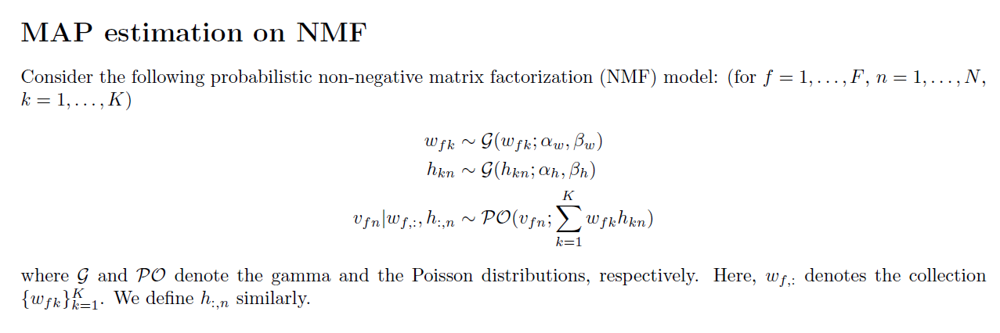

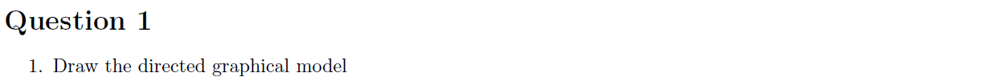

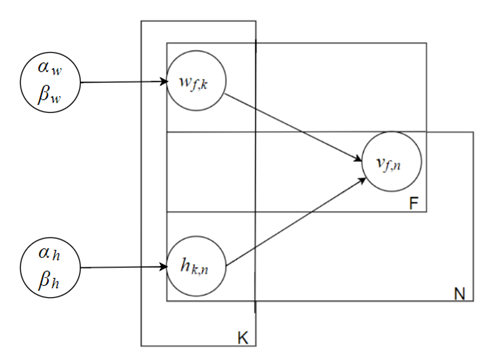


This is the directed graphical model of our non-negative matrix factorization.

In this model, we used rectangle to group random variables that repeat.

The index on the bottom rigth corner of each rectangle indicate the number of replicates.

The observations are $ \{v_{f,n}\}$

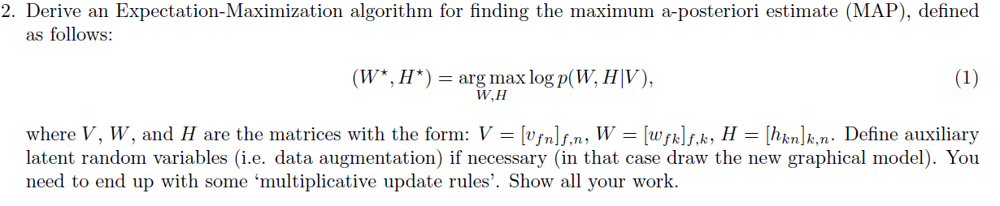

We define $ \hat V_{fn} =  \displaystyle \sum_{k=1}^{K} w_{fk}h_{kn}$

Thus, $ v_{fn} | w_{f,:},h_{:,n}  \sim \mathcal{PO}(v_{fn};\hat V_{fn}) $


Where $ w_{fk} \sim \mathcal{G}(w_{fk};\alpha_w,\beta_w) $  and  $ h_{kn} \sim \mathcal{G}(h_{kn};\alpha_h,\beta_h) $


We will derive the Expectation Maximization algorithm for finding the maximum a-posteriori estimate (MAP), defined as follows:

$ (W^*,H^*) = \displaystyle \underset{W,H}{\arg \max} \text{ } \log(p(W, H|V)) = \underset{W,H}{\arg \max} \text{ } \log(\frac{p(V|W,H) \times p(W,H)}{p(V)}) $

$p(V)$ does not depend to $W$ and $H$. So, we have :

$ (W^*,H^*)= \displaystyle \underset{W,H}{\arg \max} \text{ } \log(p(V|W,H) \times p(W,H))= \underset{W,H}{\arg \max} \text{ } \log(p(V|W,H)) + log(p(W,H)) = \underset{W,H}{\arg \max} \text{ } \log(p(V,W,H))$


We define $\{ a_{f,k,n}\}$ auxiliary latent random variables such that :
 - $ a_{f,k,n} \sim \mathcal{PO}(a_{f,k,n};w_{f,k}h_{k,n})$ 
 
 - $ V_{f,n} | a_{f,:,n} \sim \delta(v_{fn} - \displaystyle \sum_{k=1}^{K} a_{f,k,n} )$
 
 
We proceed to a data augmentation.

We define $ A = [a_{f,k,n}]_{f,k,n} $

Thus, we have this graphical model :

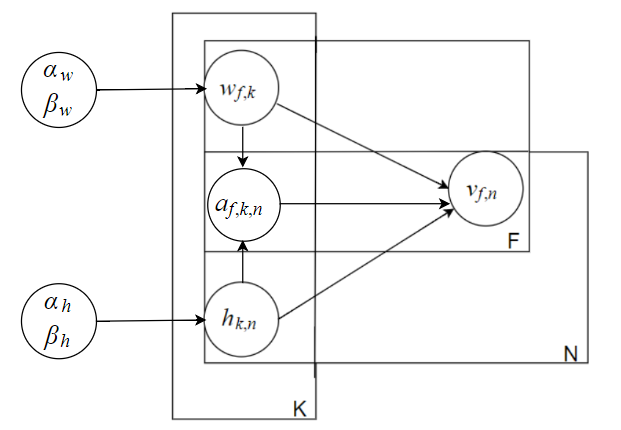

This is the new directed graphical model of our non-negative matrix factorization with the data augmentation.

In this model, we used rectangle to group random variables that repeat.

The index on the bottom rigth corner of each rectangle indicate the number of replicates.

The observations are $ \{v_{f,n}\}$

### Study of EM algorithm

In our case, the EM algorithm can be written as :

- **E-step :** $\mathcal{L}_t(W,H) = \mathbb{E}[\log(p(V,A,W,H))]_{p(A|V,W^t,H^t)} $ (t'th iteration)


- **M-step :** $(W^{t+1},H^{t+1}) = \underset{W,H}{\arg \max} \text{ } \mathcal{L}_t(W,H) $



### E-step

First of all, we have to find an expression of $\log(p(A|V,W^t,H^t))$

#### Expression of $\log(p(A|V,W^t,H^t))$

We can observe that : $p(A|V,W,H) = \displaystyle \frac{p(A,V|W,H)}{p(V|W,H)}$


We know that :



- $ a_{f,k,n}  \sim \mathcal{PO}(a_{f,k,n};w_{f,k}h_{k,n})$ 



- the poisson distibution : $ \mathcal{PO}(s; \lambda) = \exp(s \log(\lambda) -\lambda -\log(\Gamma(s + 1)))$ with $s$ an integer and $\lambda$ non negative parameter


- $p(X,Y)= p(X|Y)p(Y)$


- $ V_{f,n} | a_{f,:,n} \sim \delta(v_{fn} - \displaystyle \sum_{k=1}^{K} a_{f,k,n} )$



Thus, we have : 


- $ \log( p(A,V|W,H) ) = \log( p(V|A) ) + \log( p(A|W,H))$


$\text{   }= log( \delta(v_{fn} - \sum_{k=1}^{K} a_{f,k,n}) ) ) +  \displaystyle \sum_{f=1}^{F} \sum_{n=1}^{N} (\sum_{k=1}^{K} [ a_{f,k,n} \log(w_{f,k}h_{k,n})-w_{f,k} h_{k,n} - log( \Gamma( a_{f,k,n}+1)) ]$



- $log(p(V | W,H)) = log(\displaystyle \sum_{A} p(V | A) p(A|W,H)) = log( \prod_{f,n} \mathcal{PO}(v_{f,n};\sum_{k=1}^{K} w_{f,k} h_{k,n})) = \sum_{f=1}^{F} \sum_{n=1}^{N} v_{f,n} log(\sum_{k=1}^{K} w_{f,k} h_{k,n} ) - \sum_{k=1}^{K} w_{f,k} h_{k,n} - log(\Gamma(v_{f,n}+1 ))$


But :

- $v_{f,n}= \displaystyle \sum_{k=1}^{K} a_{f,k,n}$

- $\log(\frac{X}{Y}) = \log(X) - \log(Y)$



Thus, we have : 


$\log(p(A|V,W^t,H^t)) = \displaystyle \sum_{f=1}^{F} \sum_{n=1}^{N}  \sum_{k=1}^{K} [ ( a_{f,k,n} log(\frac{w_{f,k}^t h_{k,n}^t}{\sum_{k'=1}^{K} w_{f,k'}^t h_{k'n}^t}) - \log( \Gamma(a_{f,k,n} + 1))] + log(\delta(v_{f,n} - \sum_{k=1}^{K} a_{f,k,n})) + \log(\Gamma(v_{f,n} +1))$

$ = \sum_{f=1}^{F} \sum_{n=1}^{N} log(\mathcal {M}(a_{f,1,n},...,a_{f,K,n};v_{f,n}, \pi_{f,1,n}^t,\pi_{f,2,n}^t,...,\pi_{f,K,n}^t) )  \text{ where }  \pi_{f,k,n}^t= \displaystyle \frac{w_{f,k}^t h_{k,n}^t}{\sum_{k'=1}^{K} w_{f,k'}^t h_{k',n}^t} $ and $\mathcal {M}$ a multinomial distribution


Now, we have to find an expression of $\log(p(V,A,W,H)) $

####  Expression of $ \log(p(V,A,W,H)) $

We know that : $p(X,Y)= p(X|Y)p(Y)$

So,we can express $ p(V,A,W,H) $ like :

$ p(V,A,W,H) = p(V,A|W,H)p(W,H) = p(V|A)p(A|W,H)p(W,H) = p(V|A)p(A|W,H)p(W)p(H)$



We know also that:

- $ \mathcal{G}(w_{fk};\alpha_w,\beta_w) = \displaystyle \frac{\beta_w^{\alpha_w}w_{fk}^{\alpha_{w-1}} \exp(-\beta_w w_{fk})}{\Gamma(\alpha_{w})} $



- $ \mathcal{G}(h_{kn};\alpha_h,\beta_h) = \displaystyle \frac{\beta_h^{\alpha_h}h_{kn}^{\alpha_{h-1}} \exp(-\beta_h h_{kn})}{\Gamma(\alpha_{h})} $





Thus, we have :


$ \log(p(V,A,W,H)) = \log(p(V|A)) + \log(p(A|W,H)) + \log(p(W)) + \log(p(H))$



$= \displaystyle  \sum_{f=1}^{F} \sum_{n=1}^{N}[ log(\delta(v_{f,n} - \sum_{k=1}^{K} a_{f,k,n})) ] + \sum_{f=1}^{F} \sum_{k=1}^{K} \sum_{n=1}^{N}  [a_{f,k,n} \log(w_{f,k} h_{k,n}) -w_{f,k} h_{k,n} - \log( \Gamma(a_{f,k,n} +1) )] + \sum_{f=1}^{F}  \sum_{k=1}^{K}[ \alpha_w \log(\beta_w) + (\alpha_w -1) \log(w_{f,k}) -\beta_w w_{f,k} -\log(\Gamma(\alpha_w))] + \sum_{k=1}^{K} \sum_{n=1}^{N} [ \alpha_h \log(\beta_h) + (\alpha_h - 1) \log(h_{k,n}) -\beta_h h_{k,n} - \log(\Gamma(\alpha_h))]$



We found an expression of $ \log(p(V,A,W,H)) $.


We can simplify this formula by removing all the terms that do not depend on $(W,H)$, because we are only interested in the argmax of this expression relatively to W and H.

So we have this formula :

$  \log(p(V,A,W,H)) = \displaystyle \sum_{f=1}^{F} \sum_{k=1}^{K} \sum_{n=1}^{N}  [a_{f,k,n} \log(w_{f,k} h_{k,n}) -w_{f,k} h_{k,n}] + \sum_{f=1}^{F}  \sum_{k=1}^{K} [ (\alpha_w -1) \log(w_{f,k}) -\beta_w w_{f,k} ] + \sum_{k=1}^{K} \sum_{n=1}^{N} [ (\alpha_h - 1) \log(h_{k,n}) -\beta_h h_{k,n}] $


Now, we can find an expression $ \mathcal{L}_t(W,H)$


#### Expression of $\mathcal{L}_t(W,H)$

$\mathcal{L}_t(W,H) = \mathbb{E}[\log(p(V,A,W,H))]_{p(A|V,W^t,H^t)} $ (t'th iteration)



Consequently, we will have this expression for $\mathcal{L}_t(W,H)$ :



$= \mathbb{E}[\displaystyle \sum_{f=1}^{F} \sum_{k=1}^{K} \sum_{n=1}^{N}  [a_{f,k,n} \log(w_{f,k} h_{k,n}) -w_{f,k} h_{k,n}] + \sum_{f=1}^{F}  \sum_{k=1}^{K} [ (\alpha_w -1) \log(w_{f,k}) -\beta_w w_{f,k}] + \sum_{k=1}^{K} \sum_{n=1}^{N}  [(\alpha_h - 1) \log(h_{k,n}) -\beta_h h_{k,n}] ]_{p(A|V,W^t,H^t)} $



$ = ^+ \mathbb{E}[\log(p(A | W^t,H^t)] + \log(p(W^t)) + \log(p(H^t)) $



Moreover, we know that $\forall f , \forall n $ :

$a_{f,:,n}$ follows a multinomial law $\mathcal {M}(a_{f,:,n} ; v_{fn}, [\pi_{f,1,n},\pi_{f,2,n},...,\pi_{f,K,n}])  $ with $ \pi_{f,k,n}^t = \displaystyle \frac{w_{f,k}^t h_{k,n}^t}{\hat V_{f,n}}$



Therefore , we have :

$ \mathcal {L}_t(W,H) = ^+ \displaystyle \sum_{f=1}^{F} \sum_{k=1}^{K} \sum_{n=1}^{N}[ \mathbb{E}[a_{f,k,n}] log( w_{f,k}^t h_{k,n}^t) - w_{f,k}^t h_{k,n}^t ]  + \sum_{f=1}^{F} \sum_{k=1}^{K} [ (\alpha_w -1) \log(w_{f,k}^t) -\beta_w w_{f,k}^t ] + \sum_{k=1}^{K} \sum_{n=1}^{N}[ (\alpha_h - 1) \log(h_{k,n}^t) -\beta_h h_{k,n}^t ] $





With $\mathbb{E}[a_{f,k,n}] = v_{f,n} \pi_k^t= \displaystyle v_{f,n} \frac{w_{f,k}^t h_{k,n}^t}{\hat V_{f,n}} $



We find an expression of $\mathcal{L}_t(W,H)$


Now, we can proceed to the M-step

### M-Step



We know that, at the optimum, we shall satisfy that :

$\frac{\partial L_t(\theta)} {\partial \theta} = 0$ 


We will use this equation to find the expression of $w_{i,j}^{t+1}$ and $h_{j,z}^{t+1}$ where $ i \in [1,F]$ , $ j \in [1,K] $ and $ z \in [1,N]$


$\displaystyle \frac{\partial L_t(W,H)} {\partial w_{i,j}} = \displaystyle \sum_{n=1}^{N} v_{i,n} \frac{\displaystyle \frac{h_{j,n}^t w_{i,j}^t} {\hat v_{i,n}^t}} {w_{i,j}^{t+1}} - h_{j,n}^t + \frac{(\alpha_w -1)}{w_{i,j}^{t+1}} -\beta_w = 0$


Therefore, we have : $ w_{ij}^{t+1} = \displaystyle \frac{(\alpha_w-1) + \displaystyle \sum_{n=1}^{N} v_{i,n} \frac{h_{j,n}^t w_{i,j}^t} {\hat v_{i,n}^t} }{\beta_w + \displaystyle \sum_{n=1}^{N} h_{j,n}^t}$



In the same way, we have :

$\displaystyle \frac{\partial L_t(W,H)} {\partial h_{j,z}} = \displaystyle \sum_{f=1}^{F} v_{f,z} \frac{ \displaystyle \frac{w_{f,j}^t h_{j,z}^t} {\hat v_{f,z}^t}} {h_{j,z}^{t+1}} - w_{f,j}^t + \frac{(\alpha_h -1)}{h_{j,z}^{t+1}} -\beta_h = 0$




Therefore, we have : $ h_{j,z}^{t+1} = \displaystyle \frac{(\alpha_h-1) + \displaystyle \sum_{f=1}^{F} v_{f,z} \frac{h_{j,z}^t w_{f,j}^t} {\hat v_{f,z}^t} }{\beta_h + \displaystyle \sum_{f=1}^{F} w_{f,j}^t}$

Thus, we found an expression for $ w_{f,k}^{t+1} $ where $f$ and $k$ fixed and $ h_{k,n}^{t+1}$ where $k$ and $n$ fixed.



Now, we can deduce an expression of $W^{t+1}$ and $H^{t+1}$ in order to find $ (W^*,H^*) = \displaystyle \underset{W,H}{\arg \max} \text{ } \log(p(W, H|V)) $

### Expression of $W^{t+1}$ and $H^{t+1}$

In the previous part, we demonstrated that :


$w_{f,k}^{t+1} = \displaystyle \frac {(\alpha_w - 1) + \displaystyle \sum_{n=1}^{N} v_{f,n} \displaystyle \frac{w_{f,k}^t h_{k,n}^t}{\hat v_{f,n}^t} } {\beta_w + \displaystyle \sum_{n=1}^{N} h_{k,n}^t}$



and




$h_{k,n}^{t+1} = \displaystyle \frac {(\alpha_h - 1) + \displaystyle \sum_{f=1}^{F} v_{f,n} \displaystyle \frac{w_{f,k}^t h_{k,n}^t}{\hat v_{f,n}^t} } {\beta_h +\displaystyle \sum_{f=1} ^{F} w_{f,k}^t}$


We define:
- $M_w$,$M_h$ and $M_v$, three matrices with elements only equal to one and  which have respectively the same size than $W$,$H$ and $V$


- $\times $ : notation for the "coefficient" product between two matrices of same size


- $\div $ : notation for the "coefficient" division between two matrices of same size

Finally, we will have :



$W^{t+1} = \displaystyle \frac {(\alpha_w - 1)M_w + W^t( (V \div \hat V^t)\times(H^t)^T)} {\beta_wM_w+ M_v \times (H^t)^T}$



$H^{t+1} = \displaystyle \frac {(\alpha_h - 1)M_h + H^t ((W^t)^T \times (V \div \hat V^t))} {\beta_h M_h+ (W^t)^T \times M_v}$



We will use these expressions to implement the EM algorithm.

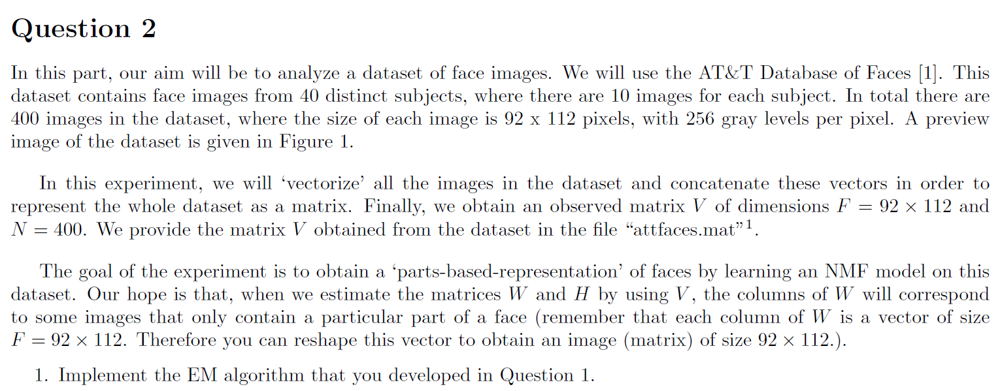

## Implementation of the algorithm

In [1]:
import numpy as np

def EM_MAP(V, alpha_w , beta_w , alpha_h , beta_h , K, nb_iter):
    
    
    #First of all, we create the constant needed to run our EM algorithm
    
    F, N = V.shape    #We retrieve F and N thanks to the dimensions of V
    M_w = np.ones((F,K))
    M_h = np.ones( (K,N))
    M_v = np.ones( (F,N))
    
    
    
    #Now , we can initialize W and H randomly.
    # W and H follow a gamma distribution
    
    W = np.random.gamma(alpha_w , 1./beta_w ,(F,K)) #np.random.gamma use as second argument the scale = 1/beta
    H = np.random.gamma(alpha_h , 1./beta_h ,(K,N))
    
    
    
    #Update of W and H
    
    for i in range(nb_iter):
        
        
        W = ( (alpha_w - 1) * M_w + W * ( ( V / (W.dot(H)) ).dot(H.T) ) ) / ( beta_w *M_w + M_v.dot(H.T) )
        H = ( (alpha_h - 1) * M_h + H * (  W.T.dot( ( V / (W.dot(H)) ) ) ) ) / ( beta_h *M_h + W.T.dot(M_v) ) 
        
    
    return W , H 

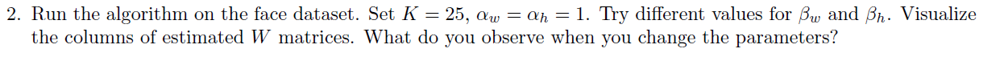

## Importation of data

We import our data contained in the "attfaces.mat" file.

In [2]:
import scipy.io as sc
import matplotlib.pyplot as plt

V = sc.loadmat("attfaces.mat")["V"] #our data are stored in a matlab file. So we have to use loadmat and retrieve the V matrice.
print(V.shape)

(10304, 400)


The dataset contains 400 images where the size of each images is $ 92 \times 112 $ pixels ($ 92 \times 112 = 10304$ ).

The size of V is good so the importation of the data has gone well.


We will create a funtion in order to visualize our next results.

##  Execution of the algorithm with $ K=25 , \alpha_w = \alpha_h = 1 $

In [3]:
W , H = EM_MAP(V, alpha_w = 1. , beta_w = 1., alpha_h = 1. , beta_h = 1. , K = 25, nb_iter = 200)

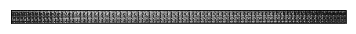

In [4]:
plt.figure()
ax = plt.gca()
ax.axes.get_xaxis().set_ticks([]) #we remove the numbers on the axis
ax.axes.get_yaxis().set_ticks([])
plt.imshow((W.dot(H)).T , plt.get_cmap("gray") ) # we have to take the transpose otherwise the faces will be upside down

We can notice that the algorithm returns a set of faces but we can not study the results. 

We have to create a function to visualize correctly the results of the algorithm and compare it with the source data.

## Visualization of the  results

Now, we have to create a function to visualize and evaluate our results.

In [5]:
def visualize_results(V, W, H, nb_faces_line) :
    
    if nb_faces_line > 20 :   #if we enter a number of faces per lines too big, we return a error message.
        message_error = "number of faces per line too big. Please enter a smaller number."
        return message_error
    
    size = (92,112)
    
    # We initialize the variables.
    
    Source_Data = np.zeros( (size[1]* nb_faces_line , size[0] * nb_faces_line ) )
    
    
    W_lines = int(W.shape[1] ** 0.5) # We visualize W columns as a square matrix.
    W_columns = int(W.shape[1] ** 0.5)
    Estimated_W_matrices = np.zeros( ( size[1] * W_lines , size[0]* W_columns) ) 
    
    
    Results = np.zeros( ( size[1]* nb_faces_line, size[0] * nb_faces_line ) )
    
    
    #Now, we have to fill out our variables.
    
    
    for i in range(W_lines):
        for j in range(W_columns):
            
            faces = W[:, i * W_lines  + j].reshape(size[0],-1).T
            Estimated_W_matrices[i * size[1]:(i+1) * size[1], j * size[0]:(j+1) * size[0]] = faces
            
            
    
    for i in range( nb_faces_line):
        
        for j in range(nb_faces_line):
            
            faces = V[:, i * nb_faces_line + j ].reshape(size[0],-1).T
            Source_Data[i * size[1]:(i+1)* size[1], j*size[0]:(j+1)* size[0]] = faces
            
            
            faces = W.dot(H)[:, i * nb_faces_line + j ].reshape(size[0],-1).T
            Results[i * size[1]:(i+1)* size[1], j * size[0]: (j+1)* size[0]] = faces
    
       
    
    #Plot of the results
    
    fig, axes = plt.subplots(1, 3, figsize=(20,10))
    
    axes[0].imshow(Source_Data, plt.get_cmap("gray"))
    axes[0].set_title("Source Data")
    
    axes[1].imshow(Estimated_W_matrices, plt.get_cmap("gray"))
    axes[1].set_title("Columns of Estimated W Matrices")
    
    axes[2].imshow(Results, cmap=plt.get_cmap("gray"))
    axes[2].set_title("Results of algorithm")
    
    for k in range(3):
        axes[k].set_xticks([])
        axes[k].set_yticks([])
        
    plt.show()

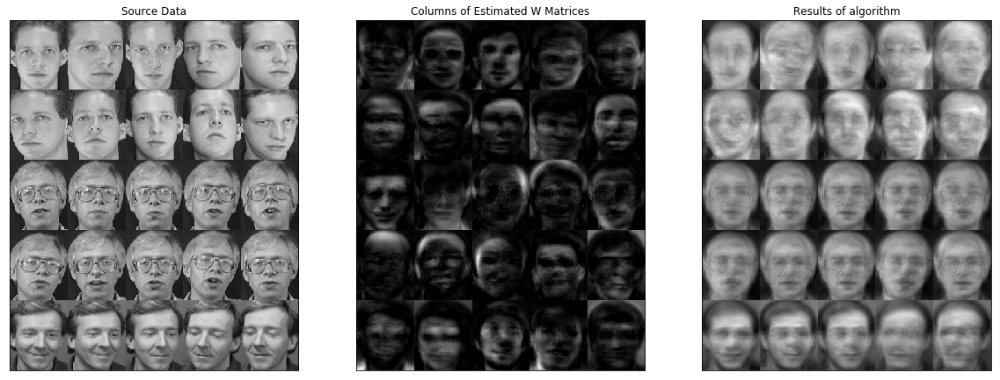

In [6]:
visualize_results(V, W, H, 5)

We created a function to visualize the results of the algorithm and compare them to the source data.

We can already remark that the results of algorithm is not very good.


We can also notice that each picture in the Columns of Estimated W matrices seems to hightlight a particular part of the face.

Ideally, to reconstruct the faces, we just have to do a linear combination of the elements of the Columns of Estimated W Matrices.



Now, we can change the values of the parameters to check their impact.

## Study of $ \beta_w $ and  $\beta_h $

beta_w and beta_h =   0.001


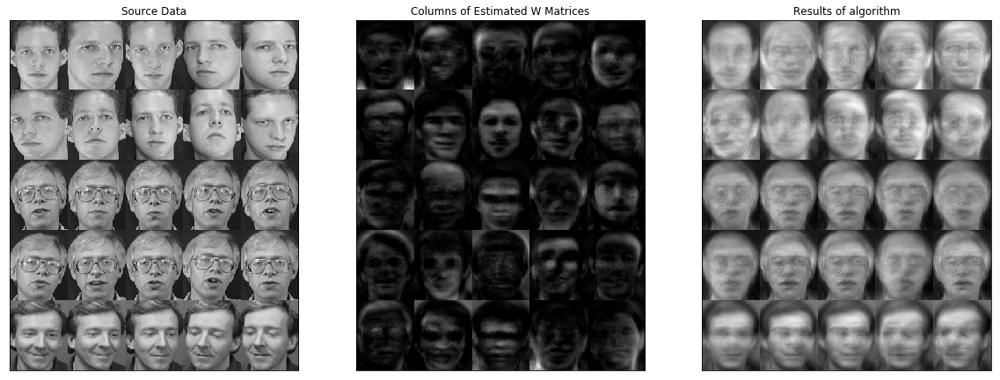

beta_w and beta_h =   10.0


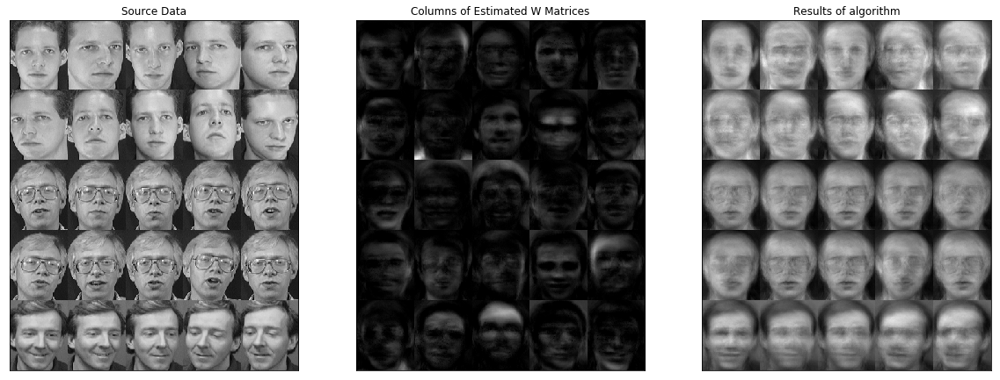

beta_w and beta_h =   50.0


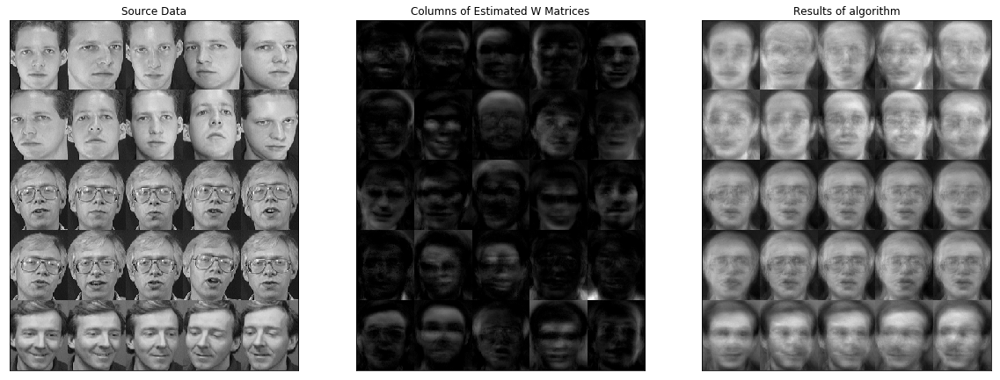

beta_w and beta_h =   100.0


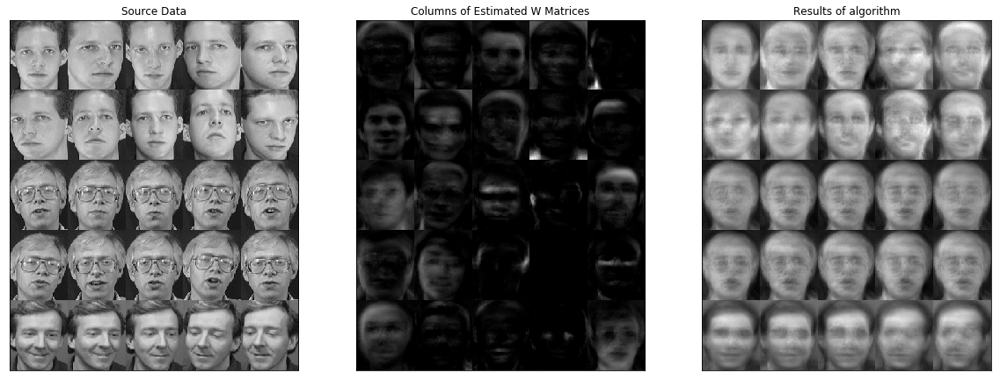

beta_w and beta_h =   150.0


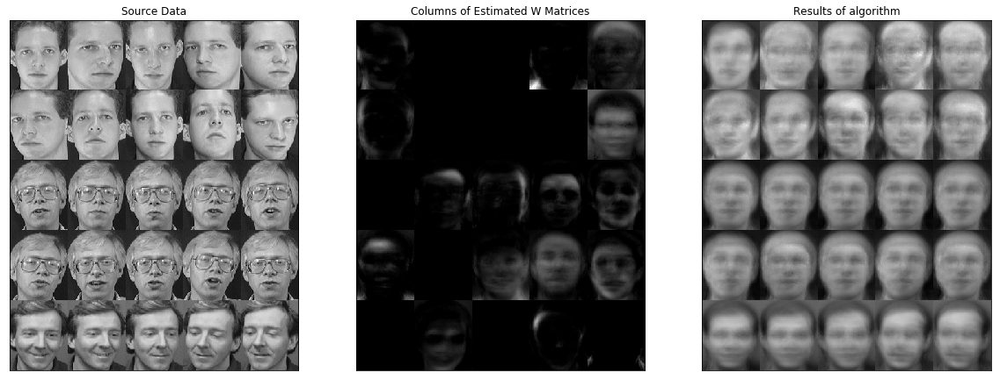

beta_w and beta_h =   200.0


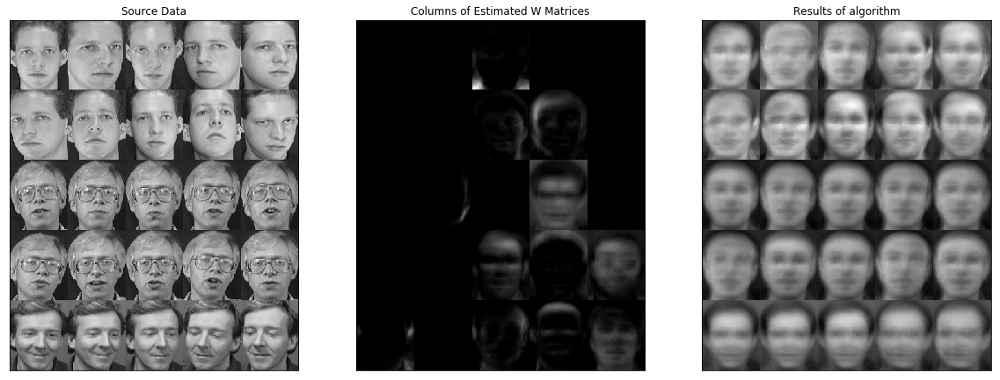

In [7]:
for i in [0.001,10.,50.,100.,150.,200.] :
     
    print("beta_w and beta_h =  " ,i)
    W , H = EM_MAP(V, alpha_w = 1. , beta_w = i, alpha_h = 1. , beta_h = i , K = 25, nb_iter = 200)
    visualize_results(V, W, H, 5)

**Warning : All output can be in the same Cell. Please scroll down to see all outputs**

Firs of all, we can remark that when we have different values for $\beta_w$ and $\beta_h$ , we do not have the same results.


When the values of $\beta$ are near of zero ,the result of the algorithm still not very good.


When $\beta$ increasing but is not too big , we have better results for the Columns of Estimated W Matrices. The results of the algorithm is a little better. We have the best result for $\beta_h=\beta_w=10$


But, when the value of $\beta$ becomming very big, the results become less good for the Columns of Estimated W Matrices and the result of the algorithm.


When $\beta$ exceed 100 , the results become not satisfactory.


Therefore, when $\beta$ is equal to 200, we have "black cells" for the Columns of Estimated W Matrices and the results of the arlgorithm are very bad.



Consequently, we can suppose that we have to take values of $\beta$ between 10 and  100 to have satisfactory results

Now, we can study $\beta_w$ and  $\beta_k$ one at a time to check if we find different results.

### Study of $\beta_w$

beta_w =   0.001


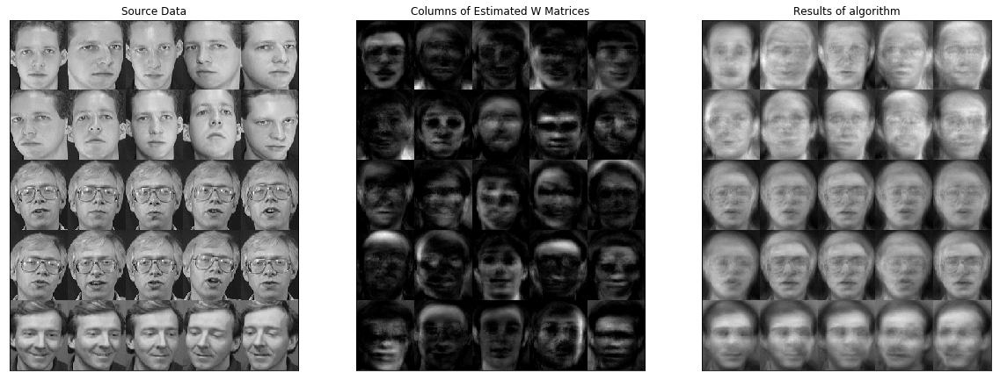

beta_w =   10.0


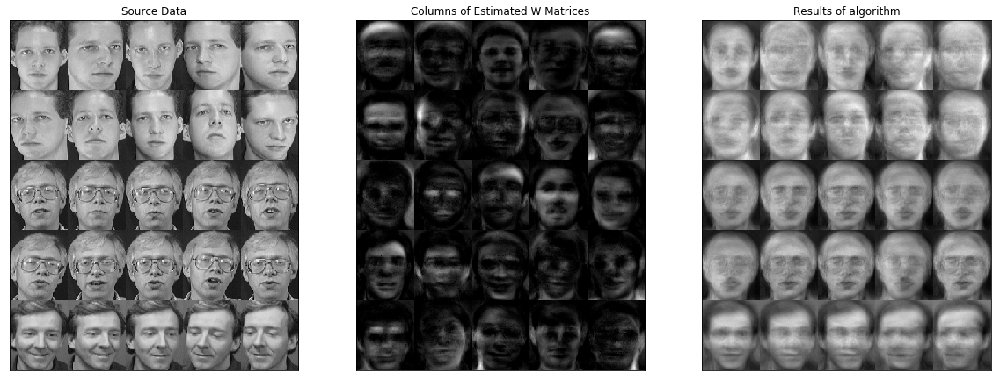

beta_w =   50.0


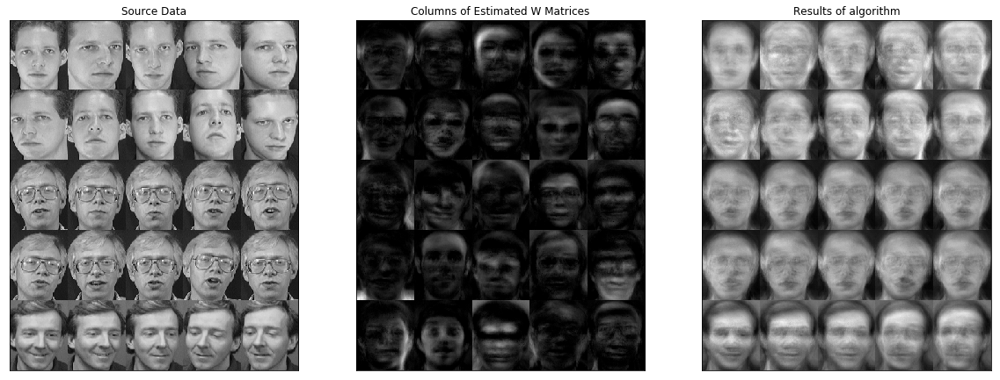

beta_w =   100.0


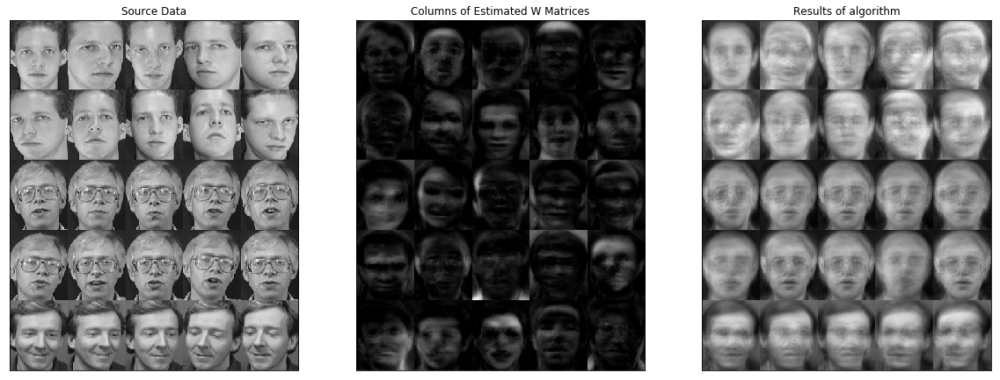

beta_w =   150.0


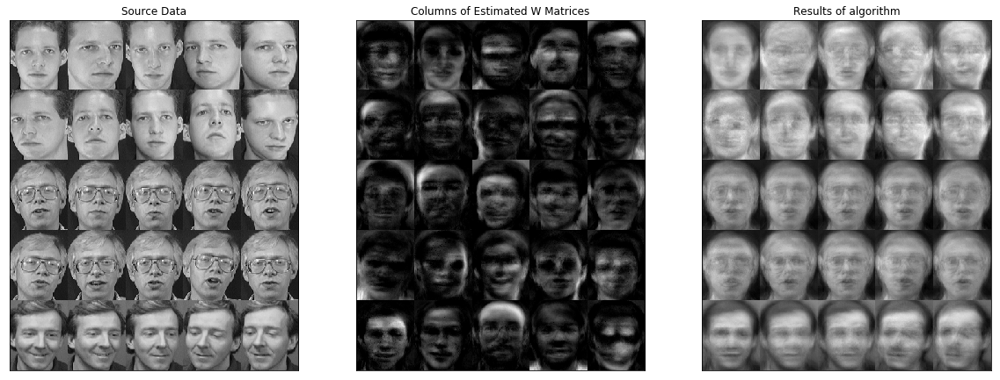

beta_w =   200.0


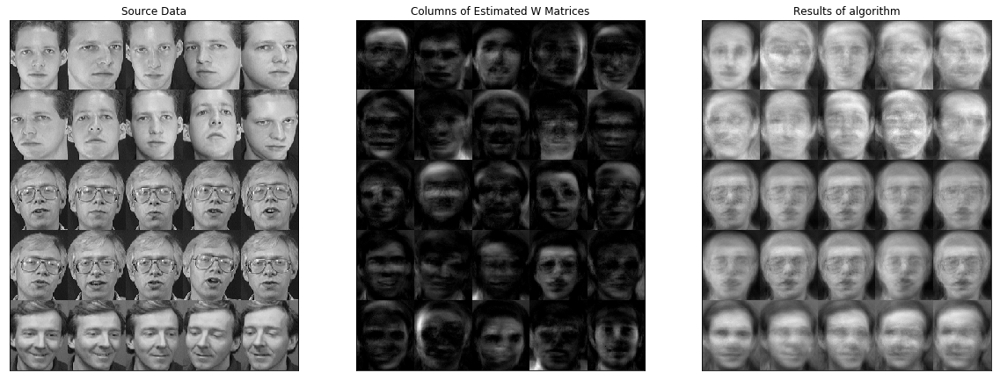

In [8]:
for i in [0.001,10.,50.,100.,150.,200.] :
     
    print("beta_w =  " ,i)
    W , H = EM_MAP(V, alpha_w = 1. , beta_w = i, alpha_h = 1. , beta_h = 1 , K = 25, nb_iter = 200)
    visualize_results(V, W, H, 5)

We can notice that when $\beta_w$ is between 50 and 100, we have the best results.

When the value becomes higher than 100, we have poorer results.

Now, we can try with $\beta_h$

### Study of $\beta_h$

beta_h =   0.001


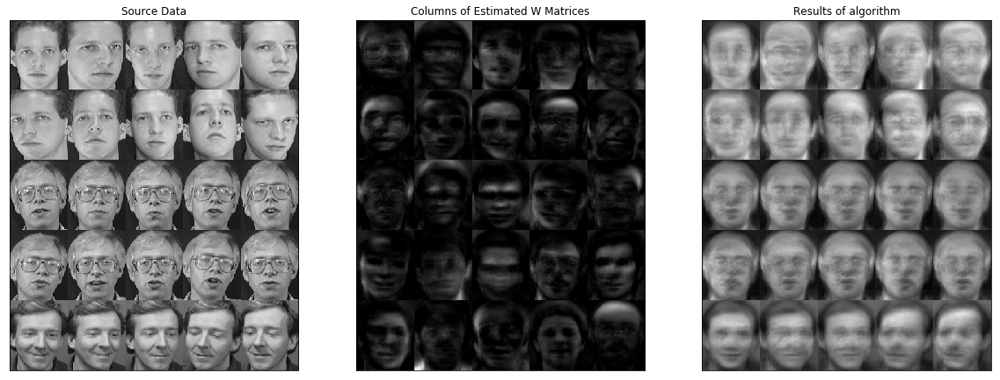

beta_h =   10.0


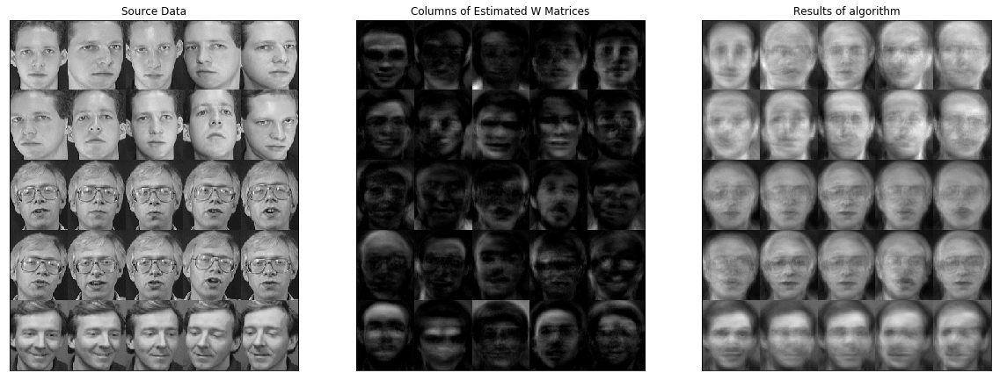

beta_h =   50.0


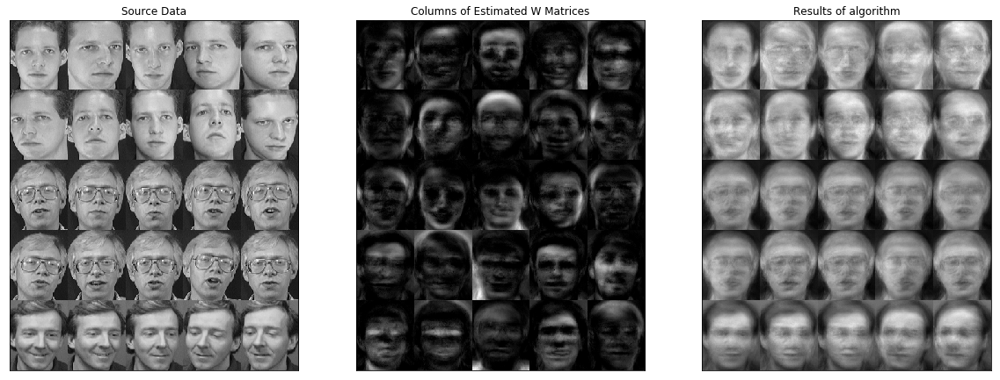

beta_h =   100.0


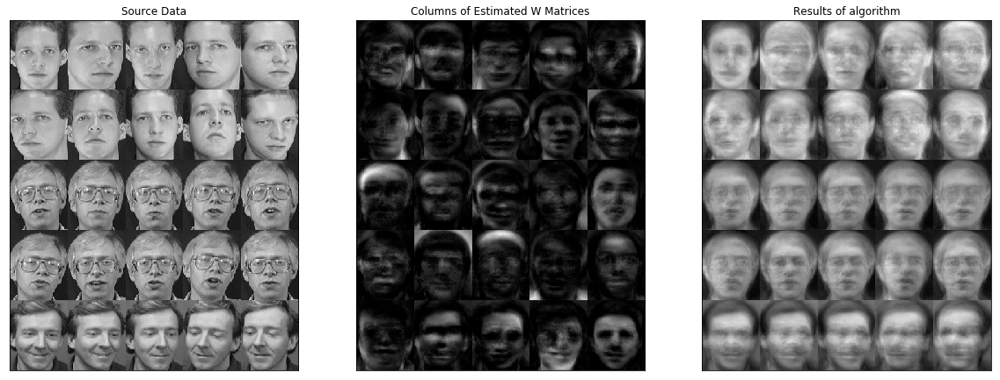

beta_h =   150.0


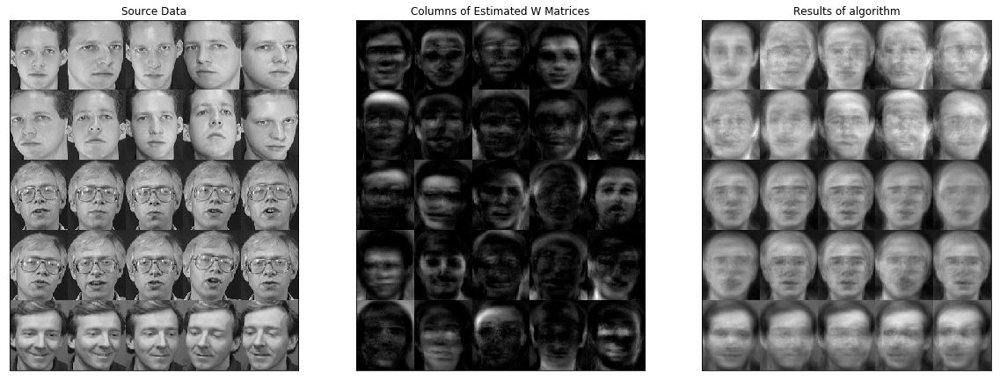

beta_h =   200.0


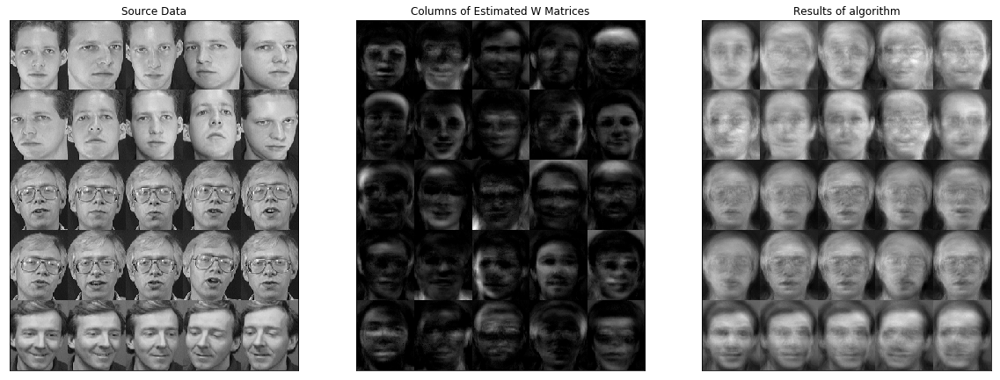

In [9]:
for i in [0.001,10.,50.,100.,150.,200.] :
     
    print("beta_h =  " ,i)
    W , H = EM_MAP(V, alpha_w = 1. , beta_w = 1., alpha_h = 1. , beta_h = i , K = 25, nb_iter = 200)
    visualize_results(V, W, H, 5)

We do not have big differences when we change the value of $\beta_h$.

Thus, the value of $\beta_h$ does not have a big impact on the results.

Consequently, we need to have a value of $\beta_w$ between 50 and 100 to  have satisfactory results.

We studied the impact of $\beta$. Now, we can do the same thing for $\alpha$

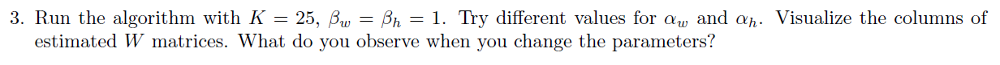

## Study of $\alpha_w$ and $\alpha_h$

alpha_w and alpha_h =   0.1


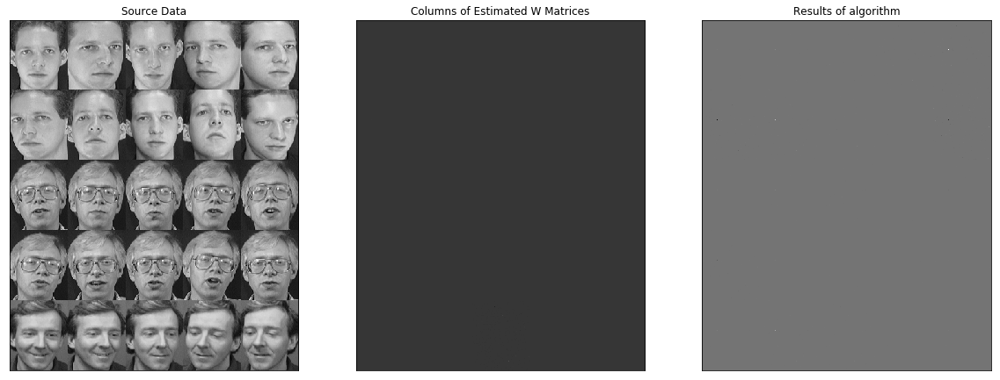

alpha_w and alpha_h =   10.0


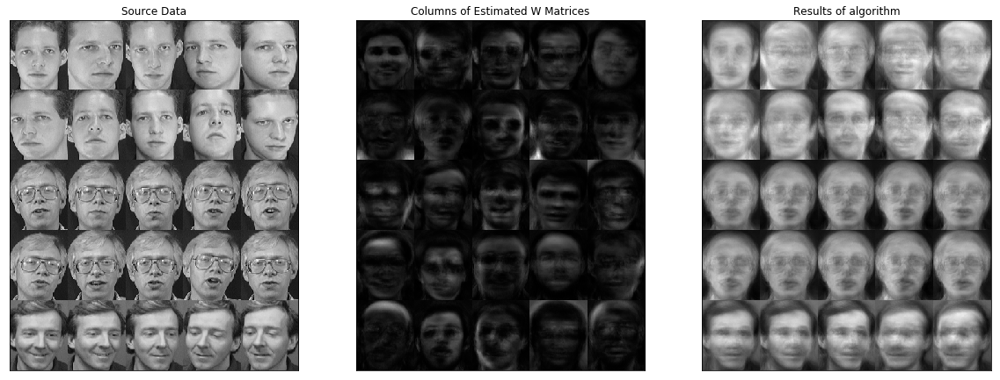

alpha_w and alpha_h =   50.0


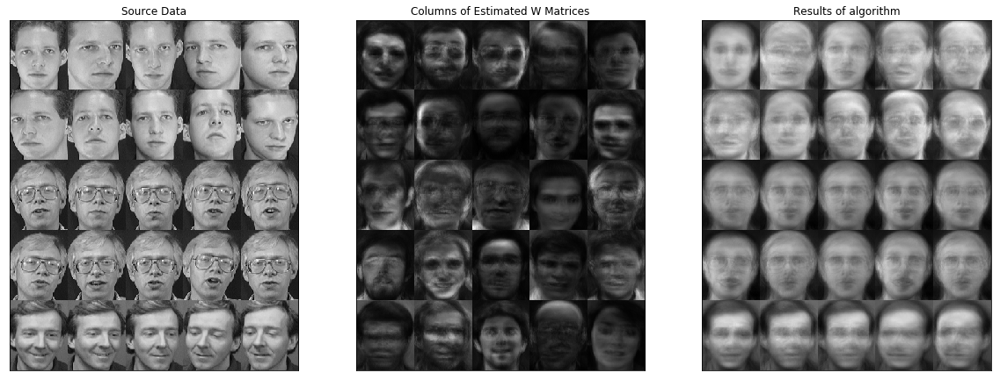

alpha_w and alpha_h =   100.0


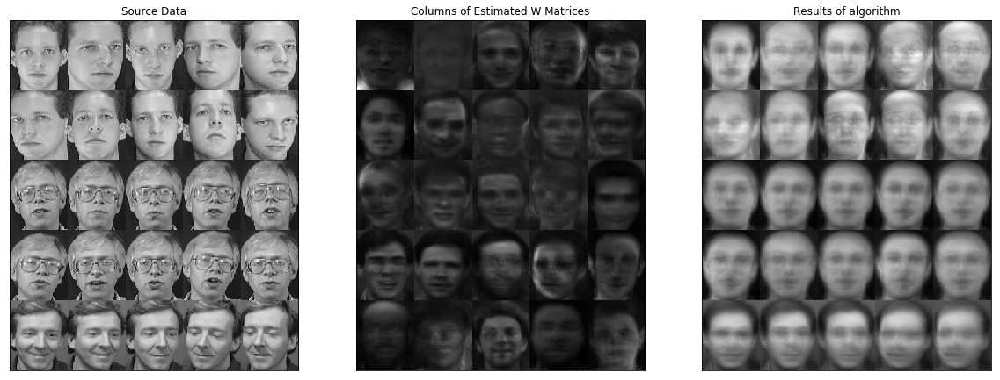

alpha_w and alpha_h =   150.0


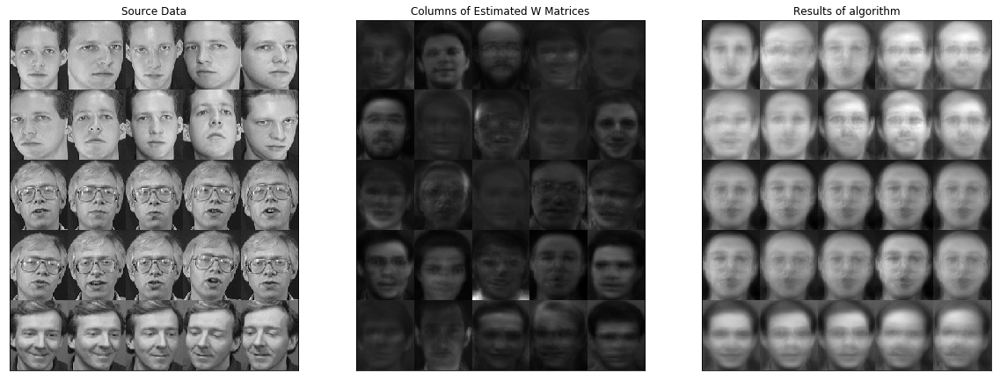

alpha_w and alpha_h =   200.0


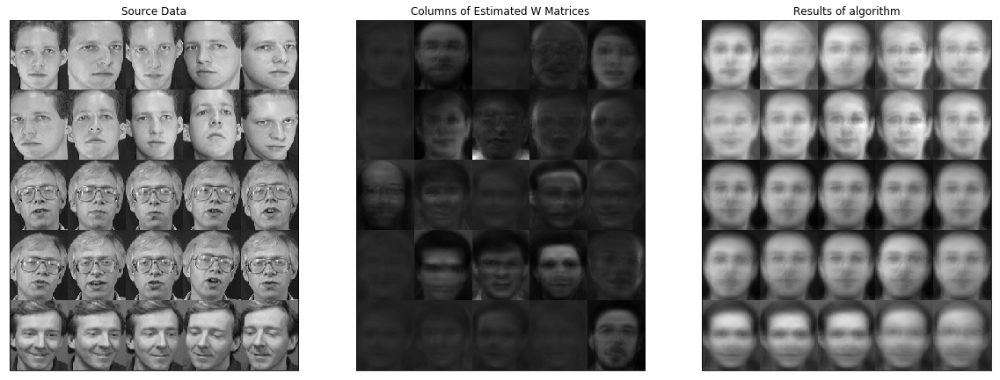

In [10]:
for i in [0.1,10.,50.,100.,150.,200.] :
     
    print("alpha_w and alpha_h =  " ,i)
    W , H = EM_MAP(V, alpha_w = i , beta_w = 1., alpha_h = i , beta_h = 1. , K = 25, nb_iter = 200)
    visualize_results(V, W, H, 5)

First of all, we can notice that when the values of $\alpha$ are very near to zero, we do not have results for the algorithm and the Columns of Estimated W Matrices.

When $\alpha$ increasing , we have better output for the Columns of Estimated W Matrices and the results of the algorithm.


But, when the values of $ \alpha $ becoming too big (higher than 50) ,the quality of the results decreasing.


Thus, when $\alpha$ is equal to 200, some part of the Columns of Estimated W Matrices are "balck cell" and the results of algorithm are not good.



Consequently, to have better results, we have to take values of $\alpha$ near of 50.

Now, we can study the $\alpha_w$ and $\alpha_h$ to check if we find the same results.

### Study of $\alpha_w$

alpha_w =   0.1


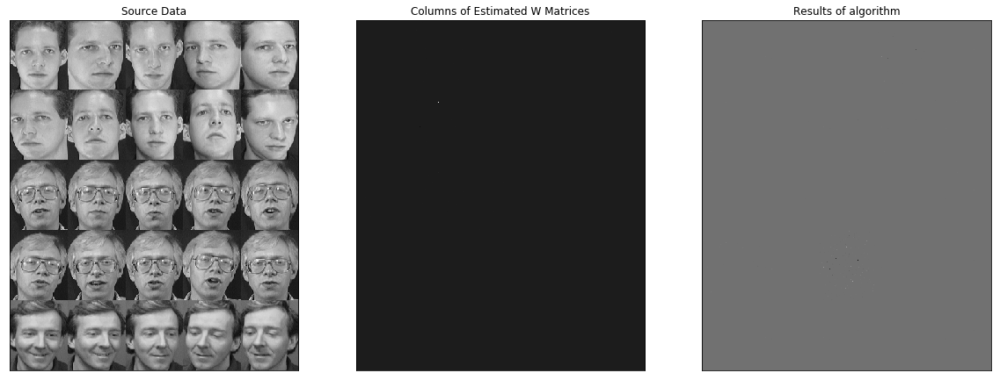

alpha_w =   10.0


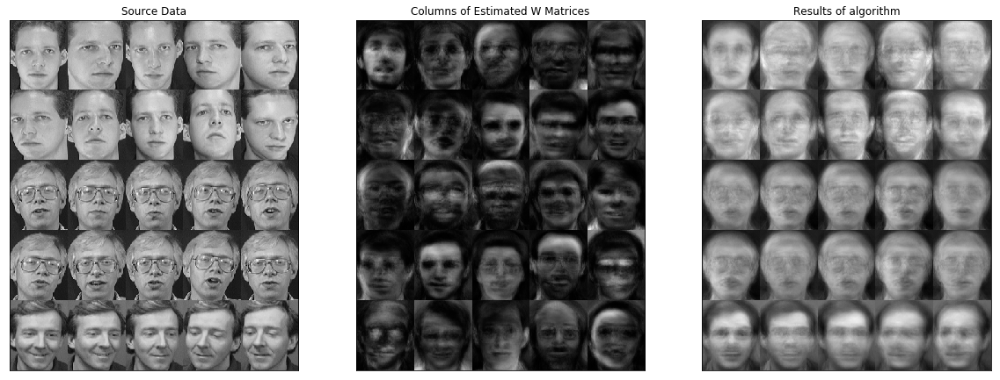

alpha_w =   50.0


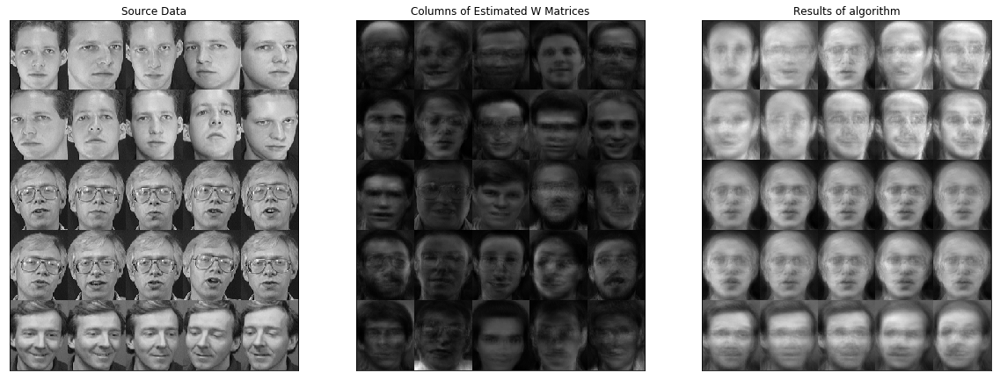

alpha_w =   100.0


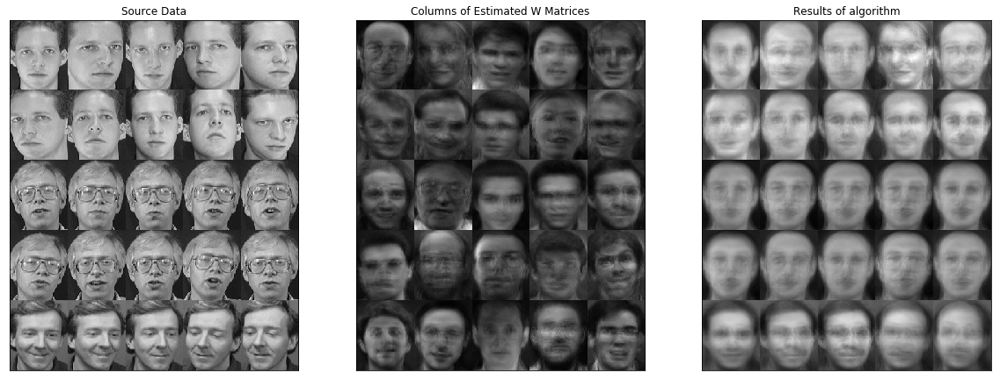

alpha_w =   150.0


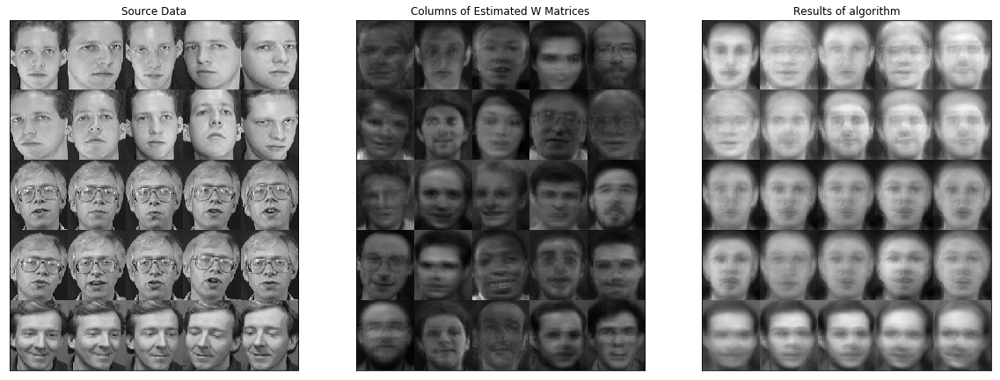

alpha_w =   200.0


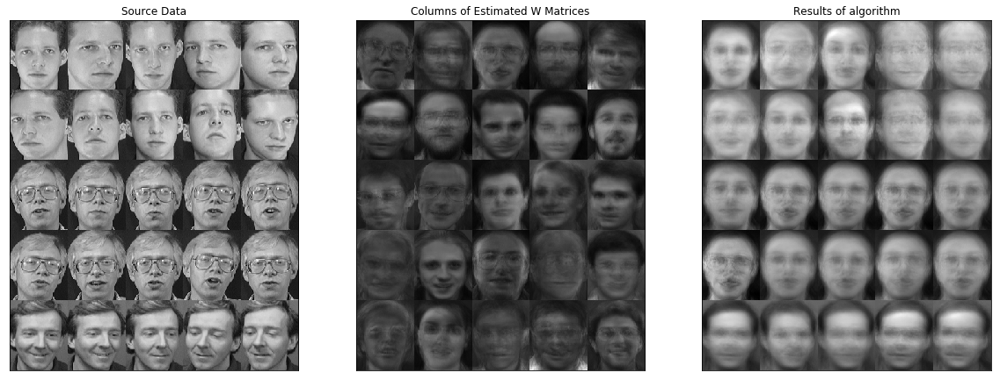

In [11]:
for i in [0.1,10.,50.,100.,150.,200.] :
     
    print("alpha_w =  " ,i)
    W , H = EM_MAP(V, alpha_w = i , beta_w = 1., alpha_h = 1. , beta_h = 1. , K = 25, nb_iter = 200)
    visualize_results(V, W, H, 5)

We obtained the same results as we studied $\alpha_w$ and $\alpha_h$ at the same time.


$\alpha_w$ must be near of 50 to have satisfactory results.

### Study of $\alpha_h$ 

alpha_h =   0.1


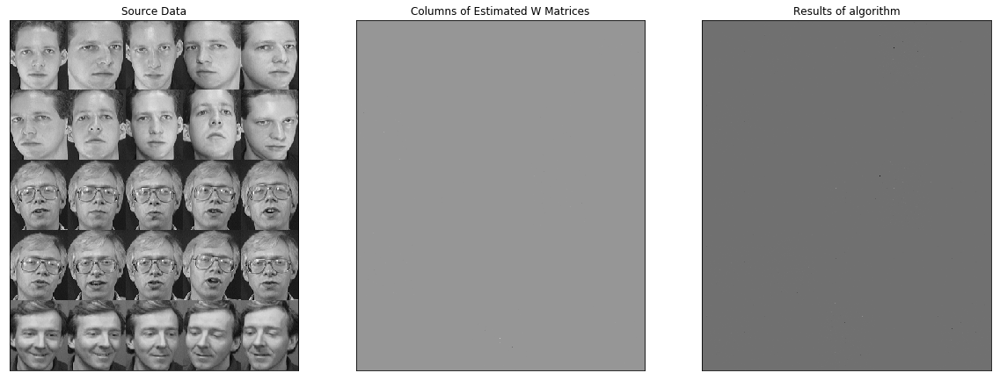

alpha_h =   10.0


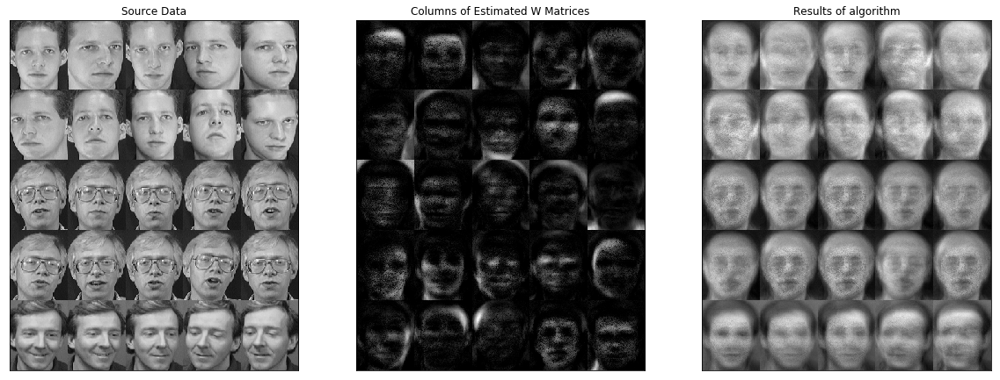

alpha_h =   25.0


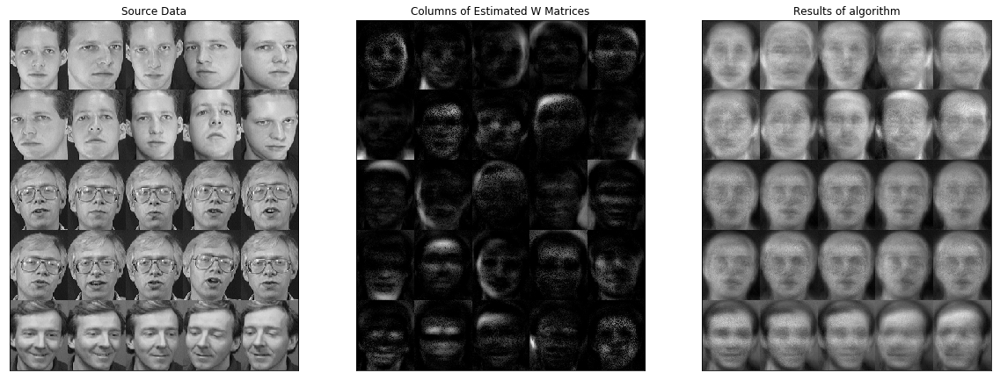

alpha_h =   50.0


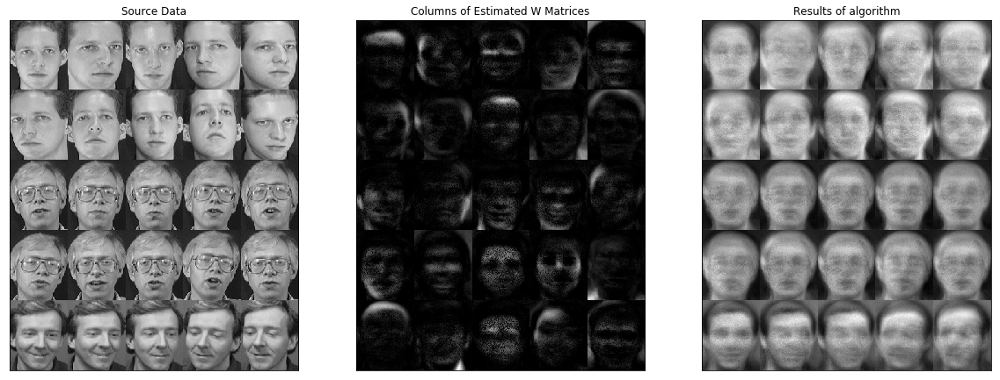

alpha_h =   100.0


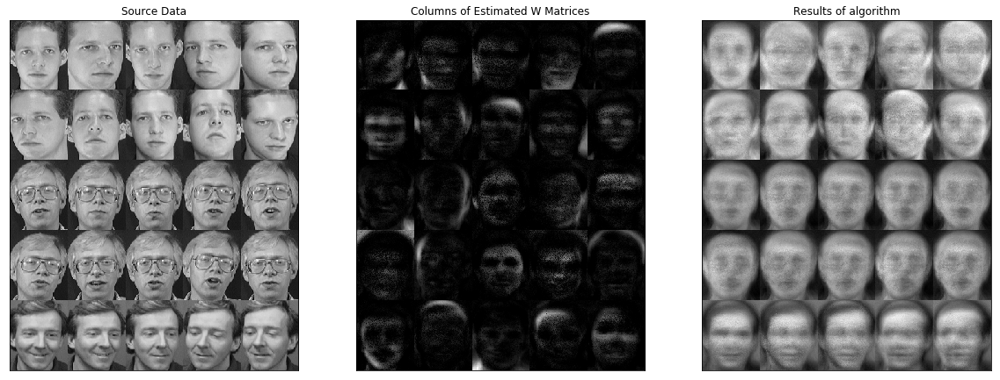

alpha_h =   150.0


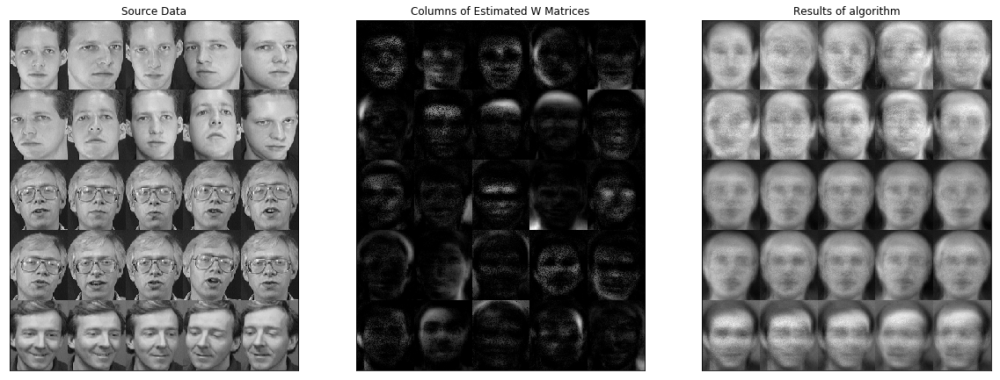

In [12]:
for i in [0.1,10.,25.,50.,100.,150.] :
     
    print("alpha_h =  " ,i)
    W , H = EM_MAP(V, alpha_w = 1. , beta_w = 1., alpha_h = i , beta_h = 1. , K = 25, nb_iter = 200)
    visualize_results(V, W, H, 5)

We obtain not very good results.When $\alpha_h$ increasing,we have a little improvement but we do not have big differences.

Thus, $\alpha_h$ just have to be big enough to have a result. In this condition, it will not have negative impact on the results.

Consequently, we will take a value of $\alpha_h$ near of 50 to fit with our previous results.

We studied the impact of $\alpha$ on the algorithm.

There is a last parameter which can be studied : K

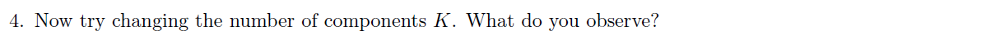

## Study of K

K =   25


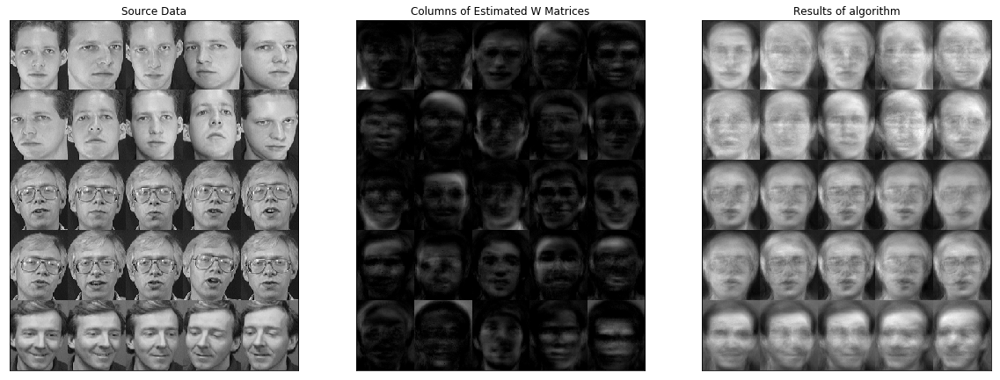

K =   50


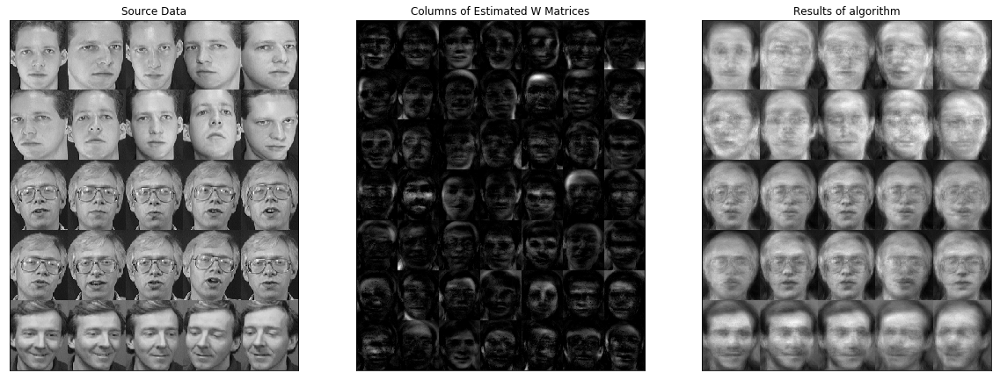

K =   100


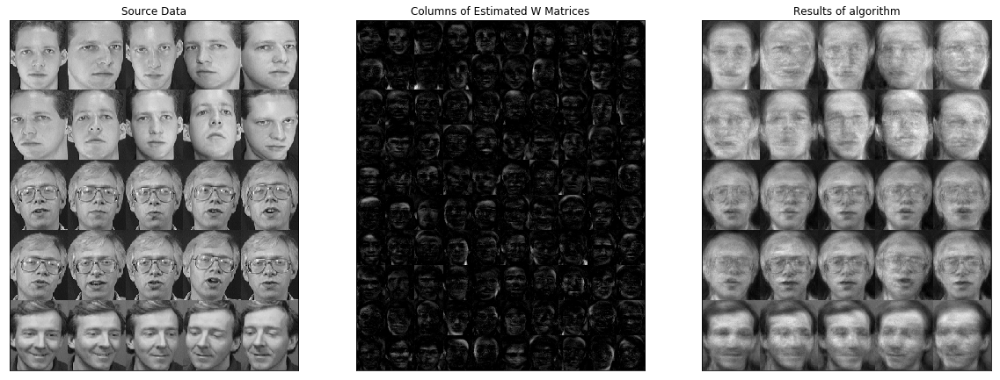

K =   150


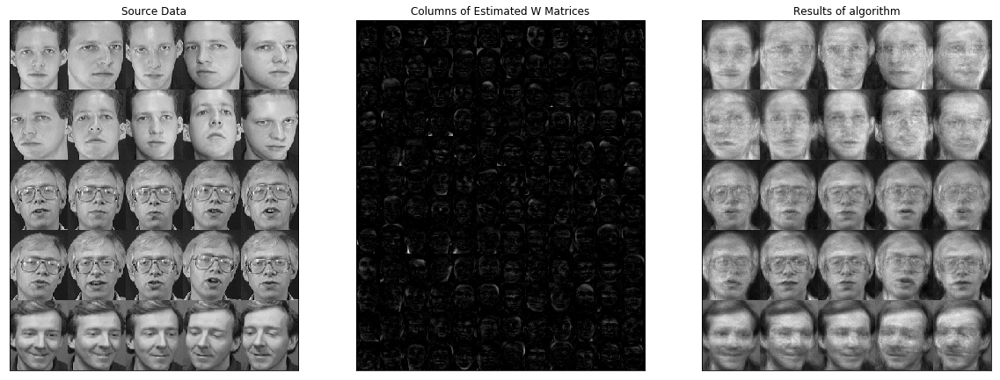

K =   200


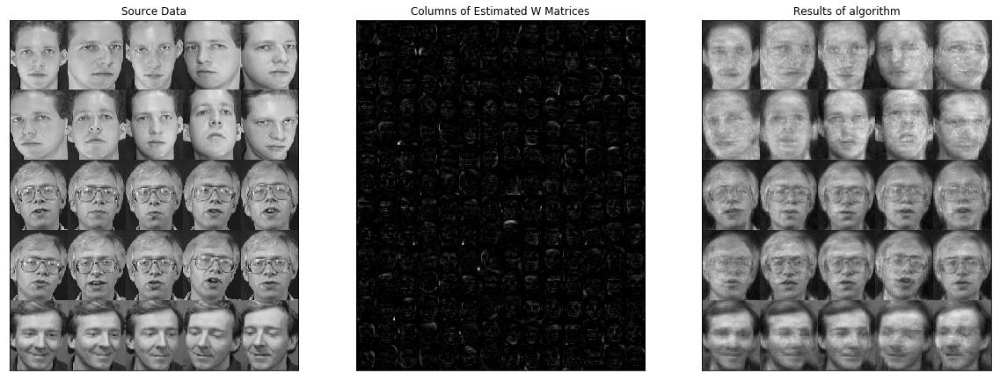

K =   250


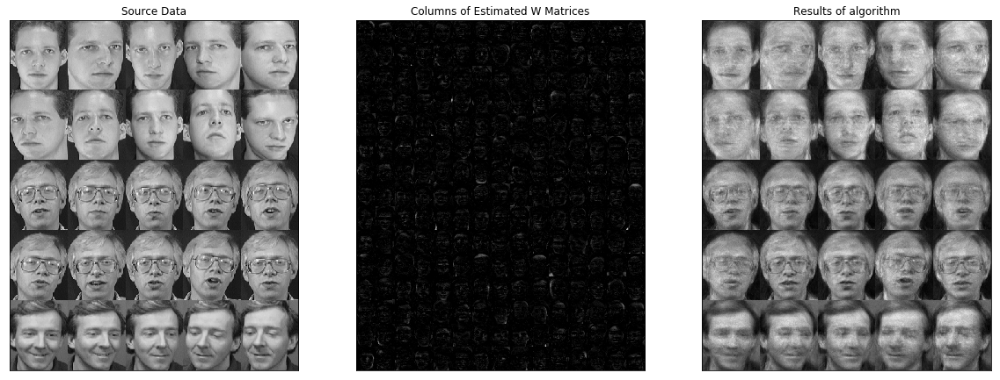

In [13]:
for i in [25,50,100,150,200,250] :
     
    print("K =  " ,i)
    W , H = EM_MAP(V, alpha_w = 1. , beta_w = 1., alpha_h = 1. , beta_h = 1. , K = i, nb_iter = 200)
    visualize_results(V, W, H, 5)

We can remark that the higher the value of K, the better results are. The results of algorithm are very good when K=250. The reconstruction is very satisfactory. For the Columns of Estimated W Matrices, just some very specific part of faces are highlited. Thus, when we proceed to the linear combination, we have very good results.

It is not suprising. When K is higher,the matrices W and H are bigger. So, we have more informations and better results.

Note that  $\alpha$ = $\beta$ =1.


Thus, if we change these coefficients with a maximal value of K, what will be the result ?

We know that : 
    

- When the mean of $\beta$  does not exceed 100 with $\beta_w $ between 50 and 100, we have better results for K=25.


- When the values of $\alpha$ are approximatively near of 50, we have better results for K=25


- When K is bigger we have better results


Thus, we visualize the results when K is big  and using  $\beta_w$ = 50 , $\beta_h$ = 1 and  $\alpha_w$= $\alpha_h$=45

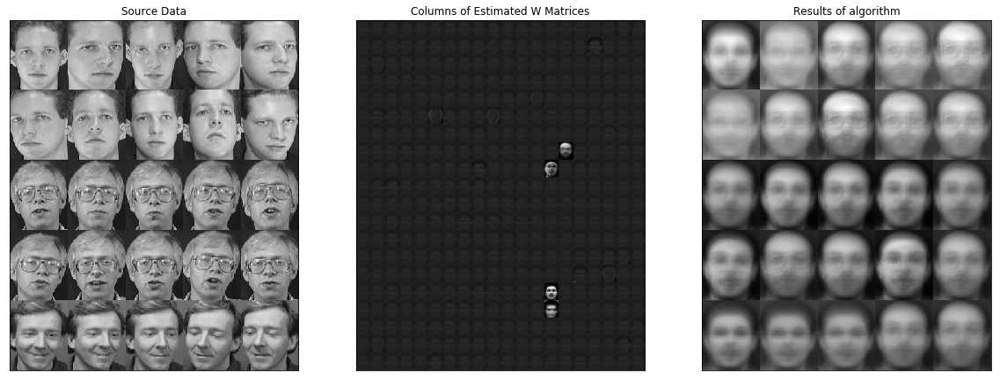

In [14]:
W , H = EM_MAP(V, alpha_w = 45. , beta_w = 50., alpha_h = 45. , beta_h = 1. , K = 400, nb_iter = 200)
visualize_results(V, W, H, 5)

We can notice that we have very bad results.

Thus, we can say that the values of $\alpha$ and $ \beta$ have to  be higher if K is little and smaller if K is big 

Thus, when K is big, we have to change the values of $\alpha$ and  $\beta$ and take them as little as possible.

## Conclusion

Thus, if we take K=400 and $\alpha_w = \alpha_h = \beta_w = \beta_h = 1 $, we will have very satisfactory results :

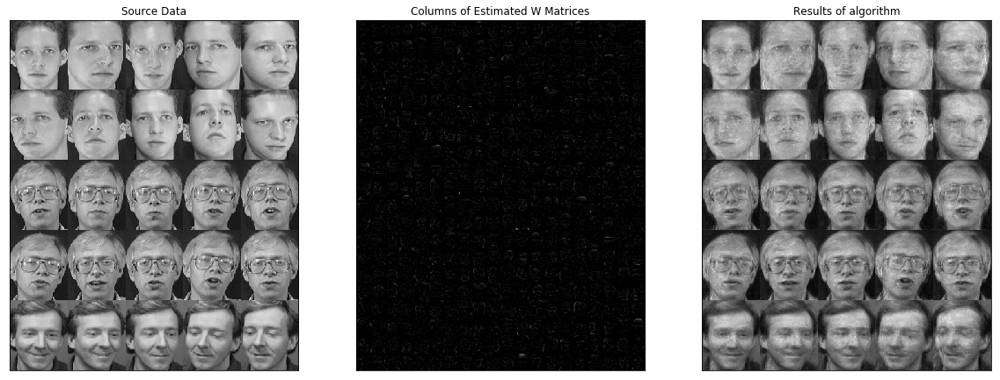

In [15]:
W , H = EM_MAP(V, alpha_w = 1. , beta_w = 1., alpha_h = 1. , beta_h = 1. , K = 400, nb_iter = 200)
visualize_results(V, W, H, 5)